In [1]:
%load_ext autoreload
%autoreload 2

import os
from pathlib import Path
import pycolmap
from tqdm import tqdm

from hloc.utils import viz_3d, parsers
from hloc.visualization import plot_images, read_image
from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_retrieval, pairs_from_exhaustive, localize_sfm

In [2]:
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.backends.cudnn.version())
print(torch.cuda.get_device_name(0))

1.13.0+cu117
11.7
8500
NVIDIA GeForce RTX 3050 Ti Laptop GPU


## 对 SportsHall_Total 数据集进三维重建（包括参考图像和查询图像）作为真值

配置路径和参数

In [2]:
my_datasets = ['House11', 'SportsHall', 'SportsHall_Total']  # 11号楼、体育馆
sfm_dataset = Path('datasets/' + my_datasets[2])  # 用于三维重建的数据集

img_names = [r.relative_to(sfm_dataset).as_posix() for r in sfm_dataset.iterdir()]  # 全部图像相对于数据集根目录的文件名

reference_imgs = sfm_dataset / 'reference/'  # 参考图像文件夹
reference_names = [r.relative_to(sfm_dataset).as_posix() for r in reference_imgs.rglob("*/*")]  # 相对于数据集根目录的文件名

query_imgs = sfm_dataset / 'query/'  # 查询图像文件夹
query_names = [q.relative_to(sfm_dataset).as_posix() for q in query_imgs.rglob("*/*")]  # 相对于数据集根目录的文件名

outputs = sfm_dataset / 'hloc'  # 与官方不同，将outputs放置在数据集文件夹中

sfm_dir = outputs / 'Total_sfm_spsg'  # 对参考图像和查询图像一起重建得到的 SfM 模型
sfm_pairs = outputs / 'total_sfm_pairs.txt'  # 对参考图像和查询图像一起进行图像检索得到的配对
loc_pairs = outputs / 'loc_pairs.txt'  # 与查询图像配对的参考图像

retrieval = outputs / 'retrieval.h5'
features = outputs / 'features.h5'
matches = outputs / 'matches.h5'

retrieval_conf = extract_features.confs['netvlad']
feature_conf = extract_features.confs['superpoint_aachen']
matcher_conf = match_features.confs['superglue']

reference_intrinsics = outputs / 'reference_with_intrinsics.txt'  # 保存参考图像名称和估计的相机参数
query_intrinsics = outputs / 'query_with_intrinsics.txt'  # 保存查询图像名称和估计的相机参数
gt_reference_poses = outputs / 'gt_reference_poses.txt'  # 参考图像位姿真值（q4 t3）
gt_query_poses = outputs / 'gt_query_poses.txt'  # 查询图像位姿真值（q4 t3）

通过图像检索在全部图像中寻找图像对

In [ ]:
# 由于数据集相对较大，使用NetVLAD提取全局描述符并寻找与每幅图像最相似的图像
# 若数据集较小，直接进行穷举匹配
extract_features.main(retrieval_conf, sfm_dataset, feature_path=retrieval)
pairs_from_retrieval.main(retrieval, sfm_pairs, num_matched=10)  # 配对图像数目应为10-20，追求速度可用5

提取并匹配全部图像的局部特征

In [ ]:
extract_features.main(feature_conf, sfm_dataset, feature_path=features)
match_features.main(matcher_conf, sfm_pairs, features=features, matches=matches)

对全部图像运行COLMAP

In [ ]:
total_model = reconstruction.main(sfm_dir, sfm_dataset, sfm_pairs, features, matches)

## 三维重建结果保存与可视化

In [8]:
print(sfm_dir)
total_model = pycolmap.Reconstruction(sfm_dir)  # 加载三维重建模型
total_name_to_id = {img.name: i for i, img in total_model.images.items()}  # 所有图片的名称对应的id
print(total_model.summary())

datasets/SportsHall_Total/hloc/Total_sfm_spsg
Reconstruction:
	num_reg_images = 1028
	num_cameras = 1028
	num_points3D = 167922
	num_observations = 1206730
	mean_track_length = 7.18625
	mean_observations_per_image = 1173.86
	mean_reprojection_error = 1.28555


In [30]:
# 保存相机参数
with open(query_intrinsics, 'w') as f:
    for name in query_names:
        cam_id = total_model.find_image_with_name(name).camera_id
        cam = total_model.cameras[cam_id]
        params = " ".join(str(c) for c in cam.params)
        f.write(f'{name} {cam.model_name} {cam.width} {cam.height} {params}\n')
with open(reference_intrinsics, 'w') as f:
    for name in reference_names:
        cam_id = total_model.find_image_with_name(name).camera_id
        cam = total_model.cameras[cam_id]
        params = " ".join(str(c) for c in cam.params)
        f.write(f'{name} {cam.model_name} {cam.width} {cam.height} {params}\n')

In [29]:
# 保存位姿真值
with open(gt_query_poses, 'w') as f:
    for name in query_names:
        img = total_model.find_image_with_name(name)
        qvec = " ".join(str(v) for v in img.qvec)
        tvec = " ".join(str(v) for v in img.tvec)
        f.write(f'{name} {qvec} {tvec}\n')
with open(gt_reference_poses, 'w') as f:
    for name in reference_names:
        img = total_model.find_image_with_name(name)
        qvec = " ".join(str(v) for v in img.qvec)
        tvec = " ".join(str(v) for v in img.tvec)
        f.write(f'{name} {qvec} {tvec}\n')

In [3]:
# 通过图像检索寻找查询图像与参考图像之间的图像对
pairs_from_retrieval.main(retrieval, loc_pairs, num_matched=20, db_list=reference_names, query_list=query_names)

[2022/12/17 16:32:59 hloc INFO] Extracting image pairs from a retrieval database.
[2022/12/17 16:33:02 hloc INFO] Found 2400 pairs.


In [9]:
# 3D可视化
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, total_model, color='rgba(255,0,0,0.5)', name="mapping", cameras=False)
fig.show()

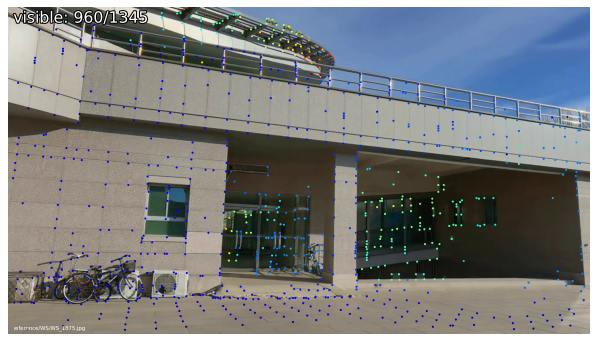

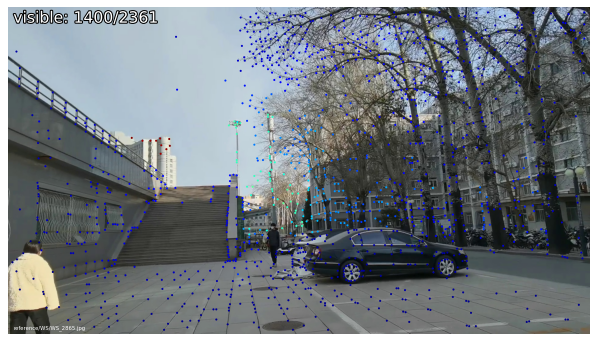

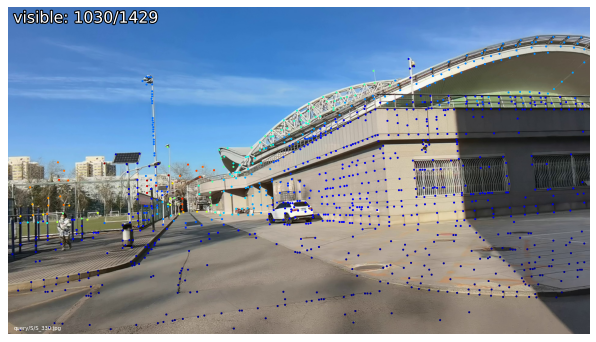

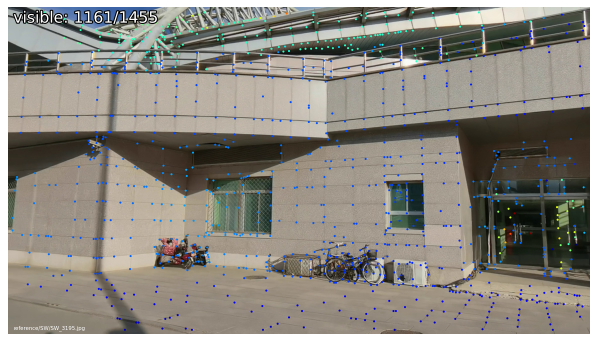

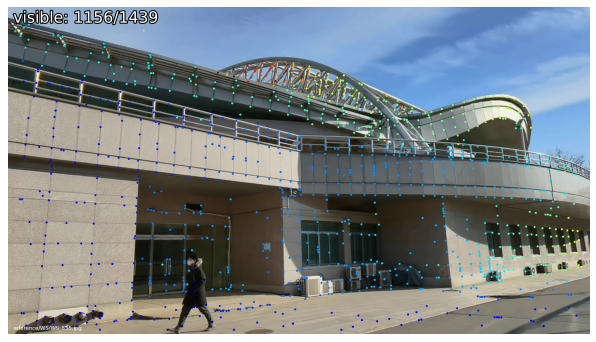

...

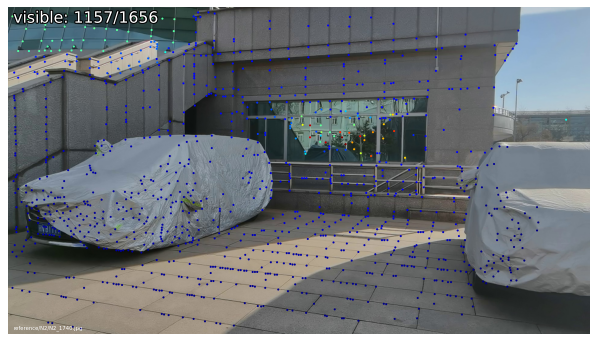

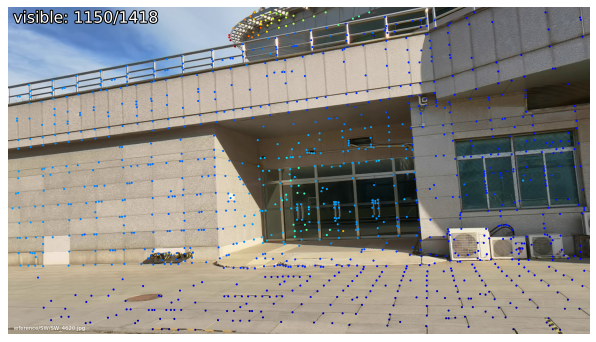

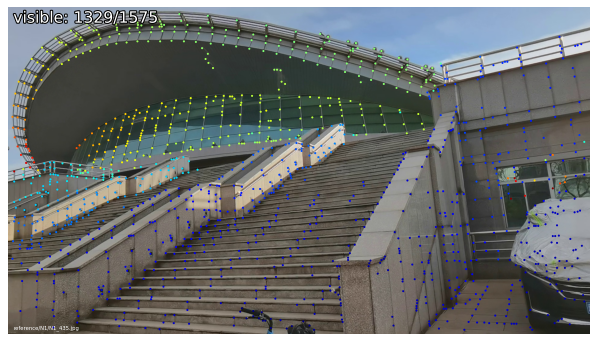

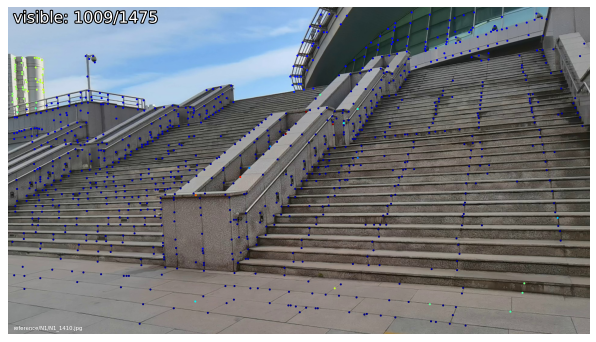

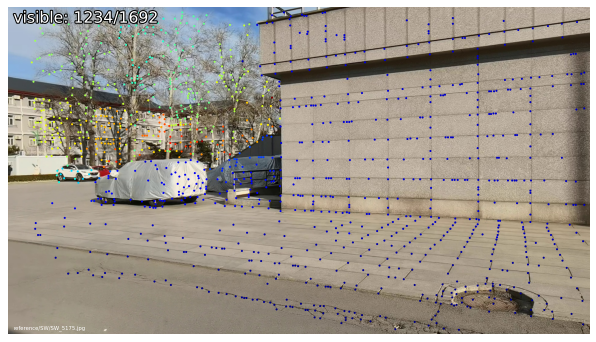

In [10]:
visualization.visualize_sfm_2d(total_model, sfm_dataset, color_by='depth', n=20)